In [3]:
#Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from scipy import stats
import os

In [4]:
#Load Data
df = pd.read_csv("benin-malanville.csv", parse_dates=["Timestamp"])

In [12]:
#Summary Statistics
print("Summary Statistics:")
display(df.describe())

Summary Statistics:


,Timestamp,GHI,DNI,DHI,ModA,ModB,Tamb,RH,WS,WSgust,WSstdev,WD,WDstdev,BP,Cleaning,Precipitation,TModA,TModB,Comments
count,525600,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,0.0
mean,2022-02-07 12:00:30.000000512,240.559452,167.187516,115.358961,236.589496,228.883576,28.179683,54.487969,2.121113,2.809195,0.473390,153.435172,8.582407,994.197199,0.000923,0.001905,35.246026,32.471736,NaN
min,2021-08-09 00:01:00,-12.900000,-7.800000,-12.600000,0.000000,0.000000,11.000000,2.100000,0.000000,0.000000,0.000000,0.000000,0.000000,985.000000,0.000000,0.000000,9.000000,8.100000,NaN
25%,2021-11-08 06:00:45,-2.000000,-0.500000,-2.100000,0.000000,0.000000,24.200000,28.800000,1.000000,1.300000,0.400000,59.000000,3.700000,993.000000,0.000000,0.000000,24.200000,23.600000,NaN
50%,2022-02-07 12:00:30,1.800000,-0.100000,1.600000,4.500000,4.300000,28.000000,55.100000,1.900000,2.600000,0.500000,181.000000,8.600000,994.000000,0.000000,0.000000,30.000000,28.900000,NaN
75%,2022-05-09 18:00:15,483.400000,314.200000,216.300000,463.700000,447.900000,32.300000,80.100000,3.100000,4.100000,0.600000,235.100000,12.300000,996.000000,0.000000,0.000000,46.900000,41.500000,NaN
max,2022-08-09 00:00:00,1413.000000,952.300000,759.200000,1342.300000,1342.300000,43.800000,100.000000,19.500000,26.600000,4.200000,360.000000,99.400000,1003.000000,1.000000,2.500000,81.000000,72.500000,NaN
std,NaN,331.131327,261.710501,158.691074,326.894859,316.536515,5.924297,28.073069,1.603466,2.029120,0.273395,102.332842,6.385864,2.474993,0.030363,0.037115,14.807258,12.348743,NaN


In [14]:
#Missing Values
missing = df.isna().sum()
print("\nMissing Values Report:")
print(missing[missing > 0])
print("\nColumns with >5% Missing Values:")
print(missing[missing > 0.05 * len(df)])


Missing Values Report:
Comments    525600
dtype: int64

Columns with >5% Missing Values:
Comments    525600
dtype: int64


In [15]:
# Outlier Detection using Z-scores
key_cols = ['GHI', 'DNI', 'DHI', 'ModA', 'ModB', 'WS', 'WSgust']
z_scores = np.abs(stats.zscore(df[key_cols].dropna()))
outliers = (z_scores > 3).any(axis=1)
print(f"\nOutlier Rows Detected: {outliers.sum()}")


Outlier Rows Detected: 7740


In [17]:
#Clean: Impute Missing with Median
df[key_cols] = df[key_cols].apply(lambda col: col.fillna(col.median()))

#Save Cleaned Data (but exclude from Git using .gitignore)
clean_path = "data/benin_clean.csv"
os.makedirs("data", exist_ok=True)
df.to_csv(clean_path, index=False)

<Figure size 1500x600 with 0 Axes>

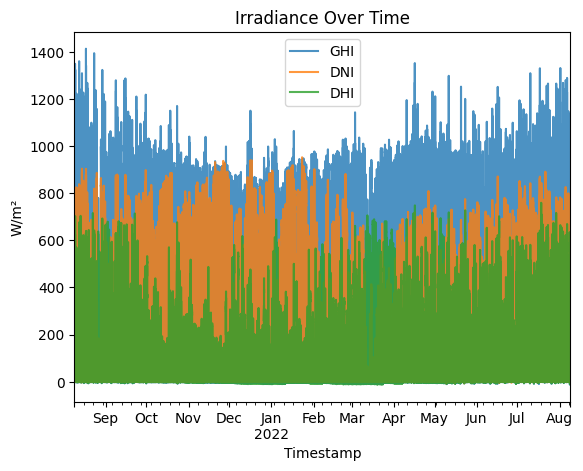

In [18]:
#Time Series Analysis
plt.figure(figsize=(15, 6))
df.set_index('Timestamp')[['GHI', 'DNI', 'DHI']].plot(title="Irradiance Over Time", alpha=0.8)
plt.ylabel("W/m²")
plt.show()

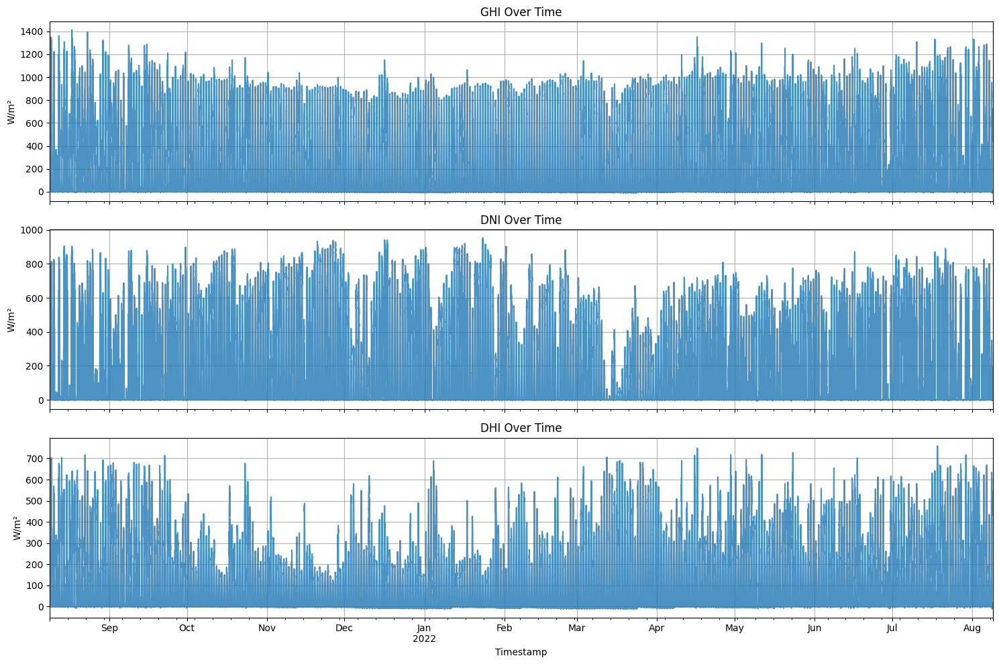

In [19]:
# Set timestamp as index
df_ts = df.set_index('Timestamp')

# Create subplots
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(15, 10), sharex=True)

# Plot each irradiance component
df_ts['GHI'].plot(ax=ax1, title="GHI Over Time", alpha=0.8)
ax1.set_ylabel("W/m²")
ax1.grid(True)

df_ts['DNI'].plot(ax=ax2, title="DNI Over Time", alpha=0.8)
ax2.set_ylabel("W/m²")
ax2.grid(True)

df_ts['DHI'].plot(ax=ax3, title="DHI Over Time", alpha=0.8)
ax3.set_ylabel("W/m²")
ax3.set_xlabel("Timestamp")
ax3.grid(True)

# Adjust layout
plt.tight_layout()
plt.show()

In [22]:
#Clean: Impute Missing with Median
df[key_cols] = df[key_cols].apply(lambda col: col.fillna(col.median()))

In [23]:
#Save Cleaned Data (but exclude from Git using .gitignore)
clean_path = "data/benin_clean.csv"
os.makedirs("data", exist_ok=True)
df.to_csv(clean_path, index=False) 

<Figure size 1500x600 with 0 Axes>

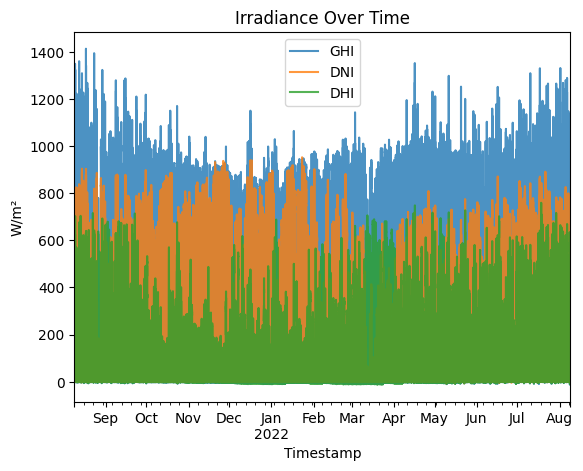

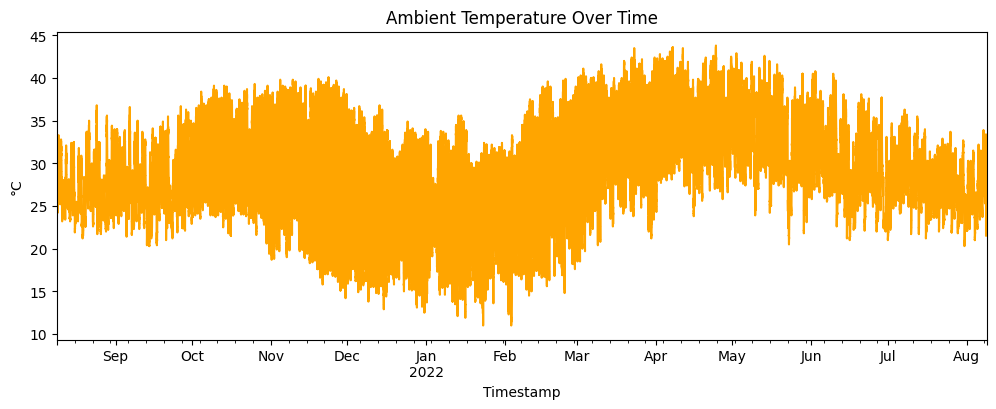

In [24]:
#Time Series Analysis
plt.figure(figsize=(15, 6))
df.set_index('Timestamp')[['GHI', 'DNI', 'DHI']].plot(title="Irradiance Over Time", alpha=0.8)
plt.ylabel("W/m²")
plt.show()

plt.figure(figsize=(12, 4))
df.set_index('Timestamp')['Tamb'].plot(title="Ambient Temperature Over Time", color='orange')
plt.ylabel("°C")
plt.show()

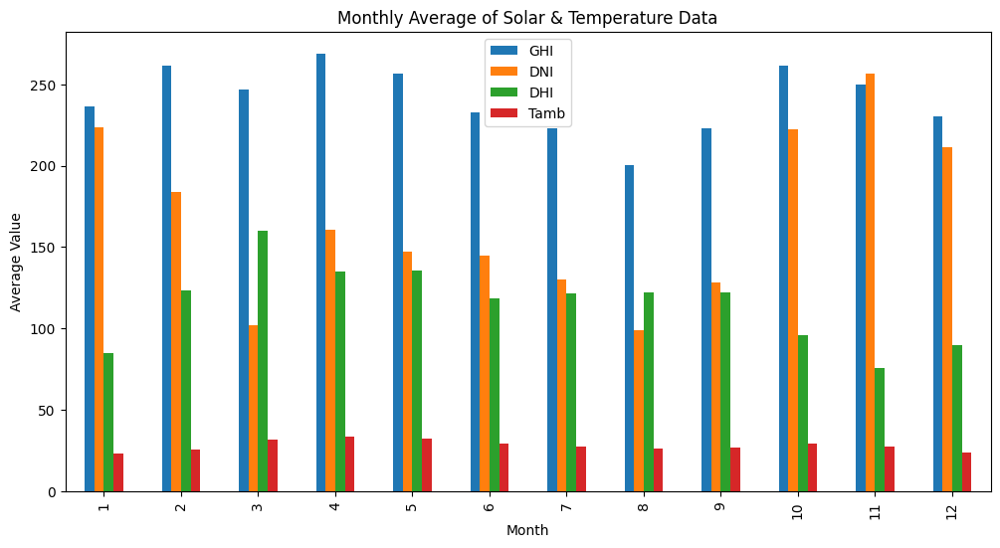

In [25]:
#Monthly Pattern Visualization
df['Month'] = df['Timestamp'].dt.month
monthly_avg = df.groupby('Month')[['GHI', 'DNI', 'DHI', 'Tamb']].mean()
monthly_avg.plot(kind='bar', figsize=(12,6), title='Monthly Average of Solar & Temperature Data')
plt.ylabel("Average Value")
plt.show()

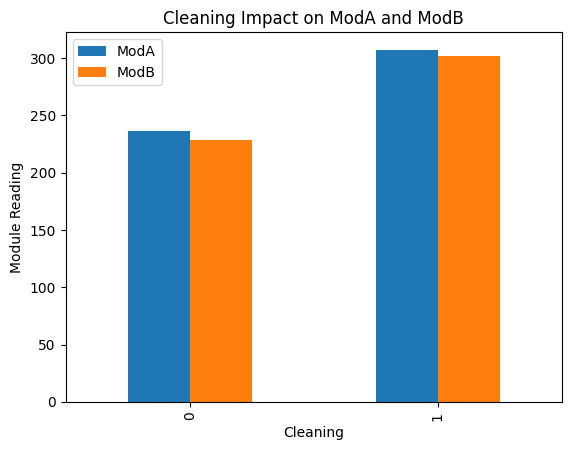

In [26]:
#Cleaning Impact (if 'Cleaning' column exists)
if 'Cleaning' in df.columns:
    df['Cleaning'] = df['Cleaning'].fillna('Unknown')
    cleaning_effect = df.groupby('Cleaning')[['ModA', 'ModB']].mean()
    cleaning_effect.plot(kind='bar', title='Cleaning Impact on ModA and ModB')
    plt.ylabel("Module Reading")
    plt.show()


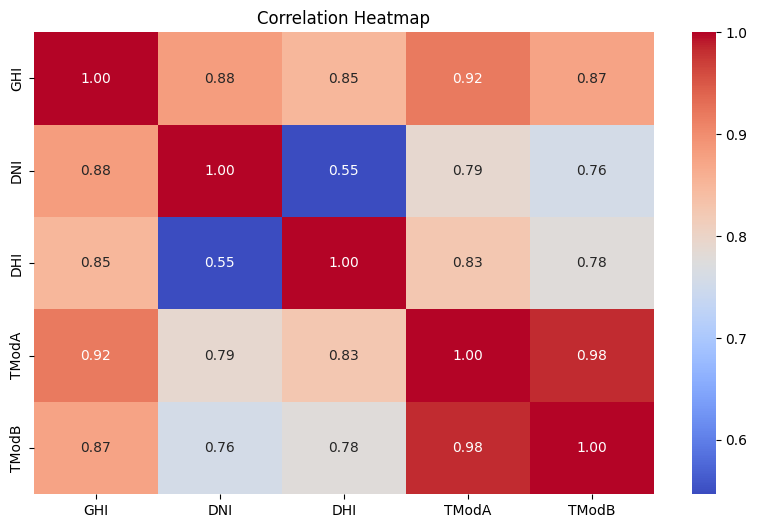

In [27]:
#Correlation Heatmap
plt.figure(figsize=(10, 6))
corr_cols = ['GHI', 'DNI', 'DHI', 'TModA', 'TModB']
sns.heatmap(df[corr_cols].corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

In [29]:
#Relationship Plots
fig1 = px.scatter(df, x='WS', y='GHI', color='WSgust', title="WS vs GHI")
fig1.show()

fig2 = px.scatter(df, x='RH', y='Tamb', title="RH vs Tamb")
fig2.show()

fig3 = px.scatter(df, x='RH', y='GHI', title="RH vs GHI")
fig3.show()

In [32]:
import plotly.express as px
import plotly.io as pio

pio.renderers.default = 'browser'  # or 'notebook' if you're in a notebook

fig1 = px.scatter(df, x='WS', y='GHI', color='WSgust', title="WS vs GHI")
fig1.show()

fig2 = px.scatter(df, x='RH', y='Tamb', title="RH vs Tamb")
fig2.show()

fig3 = px.scatter(df, x='RH', y='GHI', title="RH vs GHI")
fig3.show()

In [30]:
# Wind Rose-like Plot (simplified radial bar)
if 'WD' in df.columns and 'WS' in df.columns:
    wind_df = df[['WD', 'WS']].dropna()
    wind_df['WD_bin'] = (wind_df['WD'] // 30) * 30  # group into 30° bins
    rose_data = wind_df.groupby('WD_bin')['WS'].mean().reset_index()
    fig = px.bar_polar(rose_data, r='WS', theta='WD_bin',
                       title="Wind Rose Approximation", color='WS', color_continuous_scale='Viridis')
    fig.show()

In [6]:
import plotly.express as px
import plotly.io as pio

# Set renderer to something that works in your environment
pio.renderers.default = 'browser'  # Try 'notebook' or 'notebook_connected' if in Jupyter

# Wind Rose Plot (simplified)
if 'WD' in df.columns and 'WS' in df.columns:
    wind_df = df[['WD', 'WS']].dropna()
    wind_df['WD_bin'] = (wind_df['WD'] // 30) * 30  # binning by 30°
    rose_data = wind_df.groupby('WD_bin')['WS'].mean().reset_index()
    
    fig = px.bar_polar(
        rose_data,
        r='WS',
        theta='WD_bin',
        color='WS',
        title="Wind Rose Approximation",
        color_continuous_scale='Viridis'
    )
    fig.show()

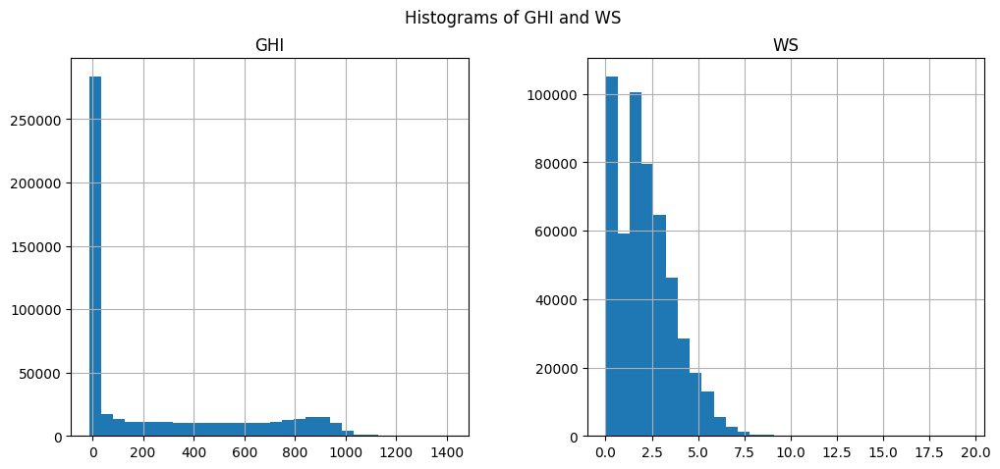

In [5]:
#Histograms
df[['GHI', 'WS']].hist(bins=30, figsize=(12, 5))
plt.suptitle("Histograms of GHI and WS")
plt.show()

In [8]:
#Temp vs RH & GHI
fig4 = px.scatter(df, x='RH', y='Tamb', color='GHI', title="RH vs Tamb (Color: GHI)")
fig4.show()

In [ ]:
#Bubble Chart: GHI vs Tamb (Bubble Size = RH)
fig5 = px.scatter(df, x='Tamb', y='GHI', size='RH', color='RH',
                  title="Bubble Chart: GHI vs Tamb (Size=RH)", size_max=20)
fig5.show()
# fig5 = px.scatter(df, x = 'Tamb', y = 'GHI', size = 'RH', titl)